In [ ]:
# Imports
from ultralytics import YOLO
import torch
import cv2
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import os
import shutil
from pathlib import Path
from tqdm.auto import tqdm
import json
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils.class_weight import compute_class_weight
from sklearn.model_selection import train_test_split
from tensorflow.keras.callbacks import EarlyStopping
from tqdm.auto import tqdm
import shutil
from PIL import Image
import kagglehub
import random
import os
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode
import numpy as np
from google.colab.patches import cv2_imshow

In [ ]:
# Download dataset
path = kagglehub.dataset_download("klemenko/kitti-dataset")

print("Path to dataset files:", path)

100%|██████████| 22.5G/22.5G [17:04<00:00, 23.6MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1


In [ ]:
# Define Directories
base_dir = Path('/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1')
data_path = base_dir / 'data_object_image_2' / 'training' / 'image_2'
test_path = base_dir / 'data_object_image_2' / 'testing' / 'image_2'
label_path = base_dir / 'data_object_label_2' / 'training' / 'label_2'

# Define a dictionary mapping
classes = {
    'Car': 0,              # Label for Car
    'Pedestrian': 1,       # Label for Pedestrian
    'Van': 2,              # Label for Van
    'Cyclist': 3,          # Label for Cyclist
    'Truck': 4,            # Label for Truck
    'Misc': 5,             # Label for miscellaneous objects
    'Tram': 6,             # Label for Tram
    'Person_sitting': 7    # Label for a person sitting
}


In [ ]:
# Generate sorted list
data = sorted(list(data_path.glob('*')))
labels = sorted(list(label_path.glob('*')))


In [ ]:
pairs = list(zip(data, labels))
pairs[:2]


[(PosixPath('/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/data_object_image_2/training/image_2/000000.png'),
  PosixPath('/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/data_object_label_2/training/label_2/000000.txt')),
 (PosixPath('/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/data_object_image_2/training/image_2/000001.png'),
  PosixPath('/root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/data_object_label_2/training/label_2/000001.txt'))]

In [ ]:
#Test Train Split
train, test = train_test_split(pairs, test_size=0.2, shuffle=True)
len(train), len(test)


(5984, 1497)

In [ ]:
# Define path
train_split_path = Path('train').resolve()
train_split_path.mkdir(exist_ok=True)
valid_path = Path('valid').resolve()
valid_path.mkdir(exist_ok=True)


In [ ]:
#Create Yolo Annotations
def convert_kitti_to_yolo(label_file, img_width, img_height):
    """Converts KITTI label format to YOLO format."""

    with open(label_file, 'r') as f:
        lines = f.readlines()

    yolo_annotations = []

    for line in lines:
        data = line.strip().split(' ')
        class_name = data[0]

        if class_name in classes:
            class_id = classes[class_name]  # Get the class ID
            x_min = float(data[4])  # Min x
            y_min = float(data[5])  # Min y
            x_max = float(data[6])  # Max x
            y_max = float(data[7])  # Max y

            # Normalize coordinates to [0, 1]
            x_center = ((x_min + x_max) / 2) / img_width  # X center
            y_center = ((y_min + y_max) / 2) / img_height  # Y center
            width = (x_max - x_min) / img_width  # Width
            height = (y_max - y_min) / img_height  # Height

            yolo_annotations.append(f"{class_id} {x_center} {y_center} {width} {height}")

    return yolo_annotations


In [ ]:
#Creating copy paths
for t_img, t_lb in tqdm(train):

    im_path = train_split_path / t_img.name
    lb_path = train_split_path / t_lb.name
    shutil.copy(t_img, im_path)
    shutil.copy(t_lb, lb_path)
    img = Image.open(im_path)
    img_width, img_height = img.size
    yolo_annotations = convert_kitti_to_yolo(t_lb, img_width, img_height)

    with open(lb_path, 'w') as f:
        f.write('\n'.join(yolo_annotations))


  0%|          | 0/5984 [00:00<?, ?it/s]

In [ ]:
# Validating paths
for t_img, t_lb in tqdm(test):

    im_path = valid_path / t_img.name
    lb_path = valid_path / t_lb.name
    shutil.copy(t_img, im_path)
    shutil.copy(t_lb, lb_path)
    img = Image.open(im_path)
    img_width, img_height = img.size
    yolo_annotations = convert_kitti_to_yolo(t_lb, img_width, img_height)
    with open(lb_path, 'w') as f:
        f.write('\n'.join(yolo_annotations))


In [ ]:
#Creating YAML file
yaml_file = 'names:\n'
yaml_file += '\n'.join(f'- {c}' for c in classes)
yaml_file += f'\nnc: {len(classes)}'
yaml_file += f'\ntrain: {str(train_split_path)}\nval: {str(valid_path)}'
with open('data.yaml', 'w') as f:
    f.write(yaml_file)

# Display the content of 'data.yaml' to verify its correctness
!cat data.yaml


In [ ]:
#Load YOLOv8 Model
model = YOLO('yolov8m.yaml')
model = YOLO('yolov8m.pt')


In [ ]:
early_stopping = EarlyStopping(
    monitor='accuracy',
    min_delta=0.01,
    patience=3,
    restore_best_weights=True,
)

In [ ]:

with tf.device('/GPU:1'):

    epochs = 30
    train_results = model.train(
        data='data.yaml',
        epochs=epochs,
        patience=3,
        mixup=0.5,
        project='yolov8_Assignment',
    )


New https://pypi.org/project/ultralytics/8.3.44 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.43 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=data.yaml, epochs=1, time=None, patience=3, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=yolov8_Assignment, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False,

train: Scanning /content/train.cache... 5984 images, 0 backgrounds, 0 corrupt: 100%|██████████| 5984/5984 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/valid.cache... 1497 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1497/1497 [00:00<?, ?it/s]


Plotting labels to yolov8_Assignment/train3/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000833, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to yolov8_Assignment/train3
Starting training for 1 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/1      6.94G      1.405       1.39      1.239        209        640: 100%|██████████| 374/374 [04:59<00:00,  1.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:27<00:00,  1.72it/s]


                   all       1497       8159      0.666      0.545      0.627      0.391

1 epochs completed in 0.094 hours.
Optimizer stripped from yolov8_Assignment/train3/weights/last.pt, 52.0MB
Optimizer stripped from yolov8_Assignment/train3/weights/best.pt, 52.0MB

Validating yolov8_Assignment/train3/weights/best.pt...
Ultralytics 8.3.43 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25,844,392 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 47/47 [00:28<00:00,  1.67it/s]


                   all       1497       8159      0.666      0.544      0.628      0.391
                   Car       1337       5727      0.779      0.866      0.903      0.654
            Pedestrian        343        901      0.736      0.557      0.642      0.342
                   Van        435        577      0.519      0.652      0.638      0.455
               Cyclist        238        341      0.805      0.475      0.584      0.325
                 Truck        212        227      0.676      0.678      0.721      0.524
                  Misc        156        191      0.436      0.539       0.46      0.267
                  Tram         83        127      0.686      0.551      0.674      0.363
        Person_sitting         29         68      0.687     0.0329      0.399      0.194
Speed: 0.1ms preprocess, 3.1ms inference, 0.0ms loss, 2.5ms postprocess per image
Results saved to yolov8_Assignment/train3


In [ ]:
# Validate model
valid_results = model.val(data='data.yaml')


Ultralytics 8.3.43 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25,844,392 parameters, 0 gradients, 78.7 GFLOPs


val: Scanning /content/valid.cache... 1497 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1497/1497 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 94/94 [00:28<00:00,  3.32it/s]


                   all       1497       8159      0.664      0.546      0.629      0.391
                   Car       1337       5727      0.776      0.867      0.903      0.654
            Pedestrian        343        901       0.73       0.56      0.645      0.344
                   Van        435        577      0.516      0.653      0.639      0.455
               Cyclist        238        341      0.807      0.479      0.587      0.323
                 Truck        212        227      0.676      0.683      0.722      0.528
                  Misc        156        191      0.433      0.539       0.46      0.268
                  Tram         83        127       0.68      0.553      0.675      0.364
        Person_sitting         29         68      0.695     0.0343      0.399       0.19
Speed: 0.1ms preprocess, 6.9ms inference, 0.0ms loss, 2.0ms postprocess per image
Results saved to yolov8_Assignment/train32


In [ ]:
#Display metrics
all_metrics = valid_results.results_dict

print("\nAll Metrics:")
for key, value in all_metrics.items():
    print(f"{key}: {value}")



All Metrics:
metrics/precision(B): 0.6640000257631724
metrics/recall(B): 0.5460977171224694
metrics/mAP50(B): 0.6287419506455058
metrics/mAP50-95(B): 0.3908717812846325
fitness: 0.4146587982207198


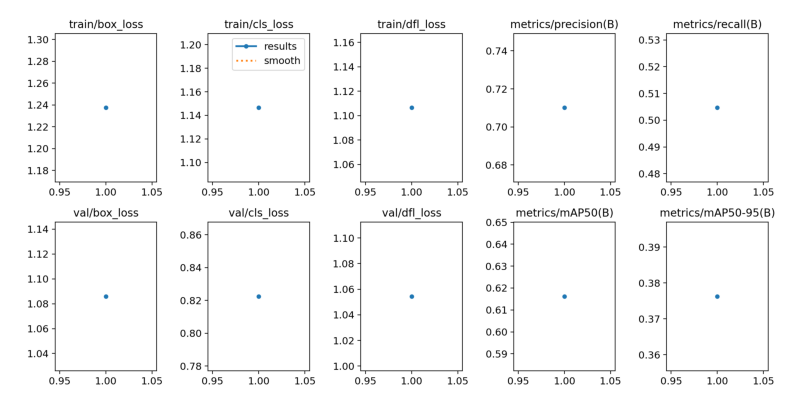

In [ ]:
#Create Graphs
plt.figure(figsize=(10, 20))
plt.imshow(Image.open('yolov8_Assignment/train/results.png'))
plt.axis('off')
plt.show()


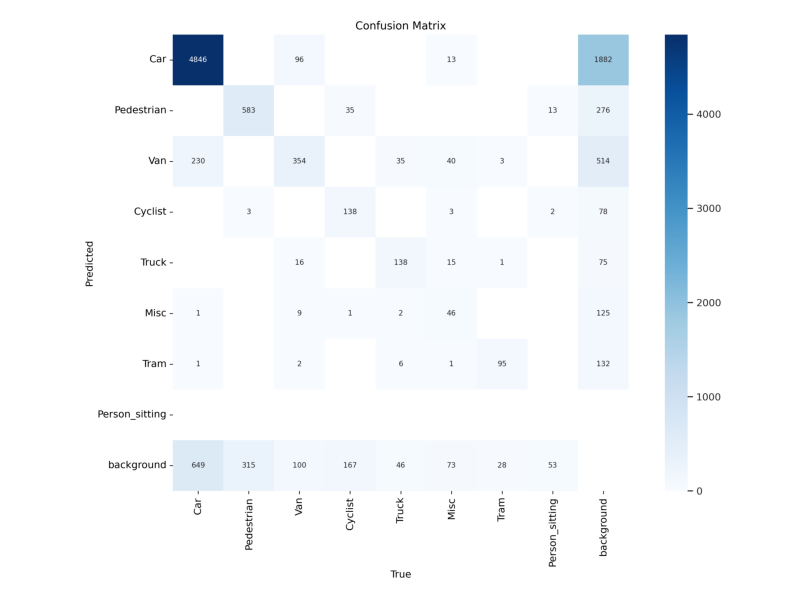

In [ ]:
plt.figure(figsize=(10,20))
plt.imshow(Image.open('yolov8_Assignment/train2/confusion_matrix.png'))
plt.axis('off')
plt.show()


image 1/1 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/data_object_image_2/testing/image_2/004680.png: 224x640 1 Car, 2 Vans, 21.0ms
Speed: 2.4ms preprocess, 21.0ms inference, 2.4ms postprocess per image at shape (1, 3, 224, 640)
Class Name: Van, Class ID: 2, Confidence: 0.8567104339599609, BBox: [403.66558837890625, 169.760009765625, 537.909912109375, 261.7603759765625]
Class Name: Van, Class ID: 2, Confidence: 0.7218784093856812, BBox: [684.3990478515625, 175.10321044921875, 738.43115234375, 227.234619140625]
Class Name: Car, Class ID: 0, Confidence: 0.40405037999153137, BBox: [403.6442565917969, 169.20242309570312, 535.3546142578125, 262.3580322265625]

image 1/1 /root/.cache/kagglehub/datasets/klemenko/kitti-dataset/versions/1/data_object_image_2/testing/image_2/000896.png: 224x640 13 Cars, 17.6ms
Speed: 3.2ms preprocess, 17.6ms inference, 2.3ms postprocess per image at shape (1, 3, 224, 640)
Class Name: Car, Class ID: 0, Confidence: 0.9182900190353394, BBox: 

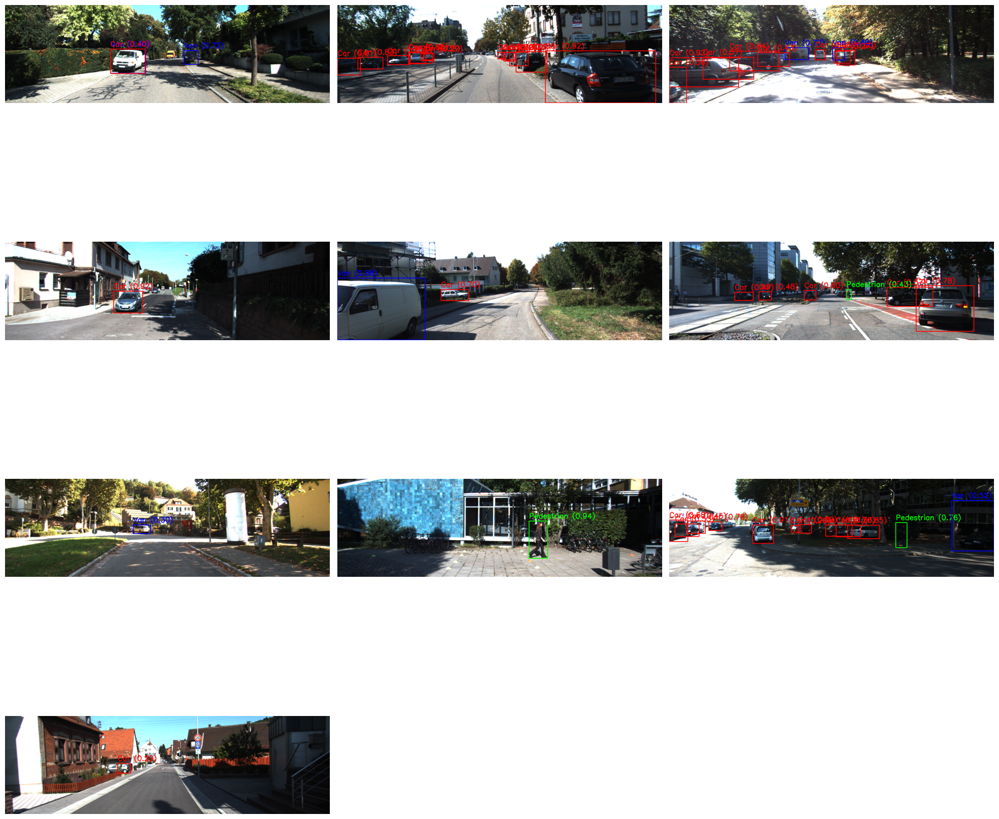

In [ ]:
colors = {
    'Car': (255, 0, 0),          # Red
    'Pedestrian': (0, 255, 0),   # Green
    'Van': (0, 0, 255),          # Blue
    'Cyclist': (255, 255, 0),    # Cyan
    'Truck': (255, 0, 255),      # Magenta
    'Misc': (0, 255, 255),       # Yellow
    'Tram': (128, 0, 128),       # Purple
    'Person_sitting': (0, 128, 0) # Dark Green
}

image_files = os.listdir(test_path)

#Run tests on test database
num_images_to_show = 10
image_paths = random.sample([os.path.join(test_path, img) for img in image_files], min(num_images_to_show, len(image_files)))

processed_images = []

class_names = list(classes.keys())

for image_path in image_paths:

    results = model.predict(image_path)
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    for result in results:
        boxes = result.boxes
        for box in boxes:
            x1, y1, x2, y2 = box.xyxy[0]
            confidence = box.conf[0]
            class_id = int(box.cls[0])


            class_name = class_names[class_id] if class_id < len(class_names) else "Unknown"
            print(f"Class Name: {class_name}, Class ID: {class_id}, Confidence: {confidence}, BBox: [{x1}, {y1}, {x2}, {y2}]")
            label_text = f"{class_name} ({confidence:.2f})"
            color = colors.get(class_name, (255, 255, 255))
            cv2.rectangle(img, (int(x1), int(y1)), (int(x2), int(y2)), color, 2)
            cv2.putText(img, label_text, (int(x1), int(y1) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)

    processed_images.append(img)


plt.figure(figsize=(20, 20))
for i, processed_img in enumerate(processed_images):
    plt.subplot(4, 3, i + 1)
    plt.imshow(processed_img)
    plt.axis('off')
plt.tight_layout()
plt.show()

Press 'Stop' in Colab to exit the loop.


<IPython.core.display.Javascript object>


0: 480x640 2 Cars, 1 Pedestrian, 57.0ms
Speed: 4.2ms preprocess, 57.0ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


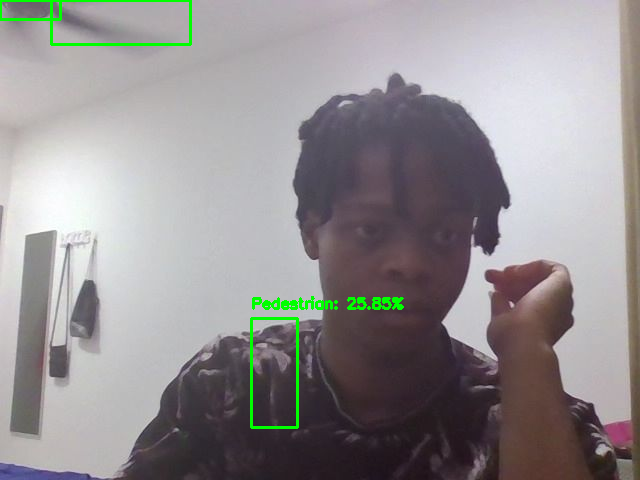

<IPython.core.display.Javascript object>


0: 480x640 1 Car, 28.1ms
Speed: 2.1ms preprocess, 28.1ms inference, 1.7ms postprocess per image at shape (1, 3, 480, 640)


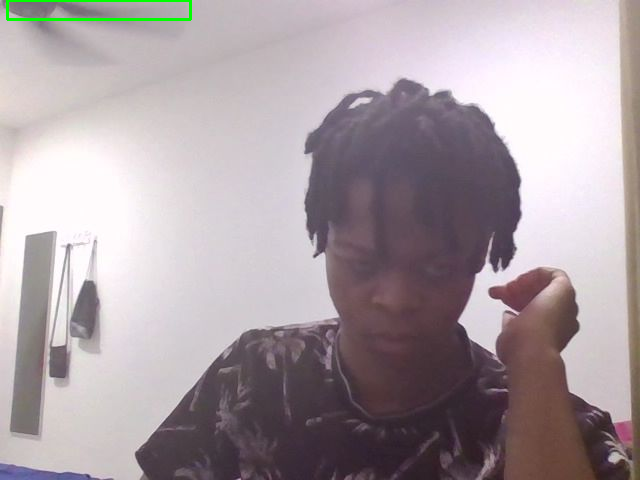

<IPython.core.display.Javascript object>


0: 480x640 1 Car, 28.1ms
Speed: 2.0ms preprocess, 28.1ms inference, 2.3ms postprocess per image at shape (1, 3, 480, 640)


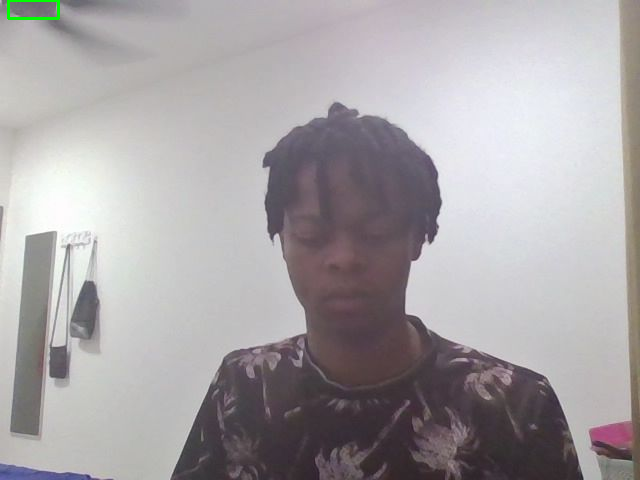

<IPython.core.display.Javascript object>


0: 480x640 (no detections), 28.2ms
Speed: 2.2ms preprocess, 28.2ms inference, 1.1ms postprocess per image at shape (1, 3, 480, 640)


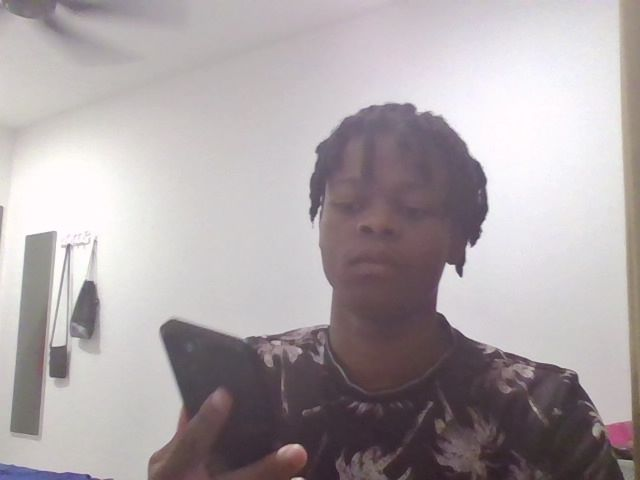

<IPython.core.display.Javascript object>


0: 480x640 3 Cars, 1 Pedestrian, 28.1ms
Speed: 1.9ms preprocess, 28.1ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


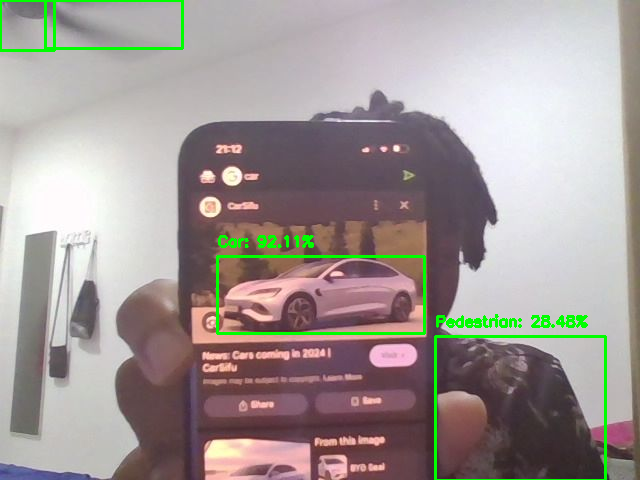

<IPython.core.display.Javascript object>


0: 480x640 3 Cars, 28.1ms
Speed: 1.9ms preprocess, 28.1ms inference, 1.5ms postprocess per image at shape (1, 3, 480, 640)


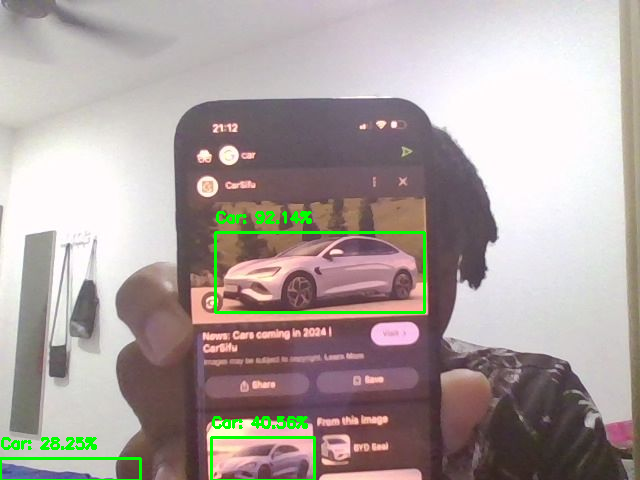

<IPython.core.display.Javascript object>


0: 480x640 1 Car, 28.1ms
Speed: 1.9ms preprocess, 28.1ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


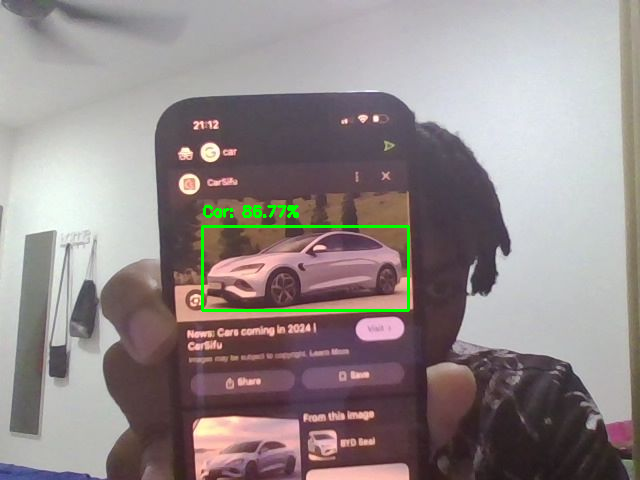

<IPython.core.display.Javascript object>


0: 480x640 2 Cars, 1 Truck, 28.2ms
Speed: 2.4ms preprocess, 28.2ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)


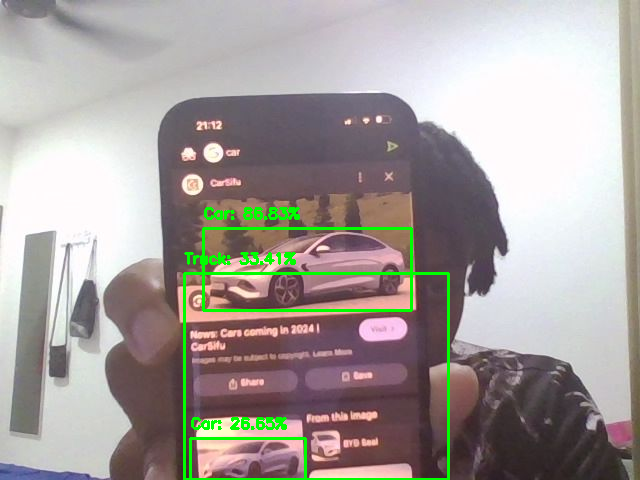

<IPython.core.display.Javascript object>


0: 480x640 (no detections), 28.1ms
Speed: 2.0ms preprocess, 28.1ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)


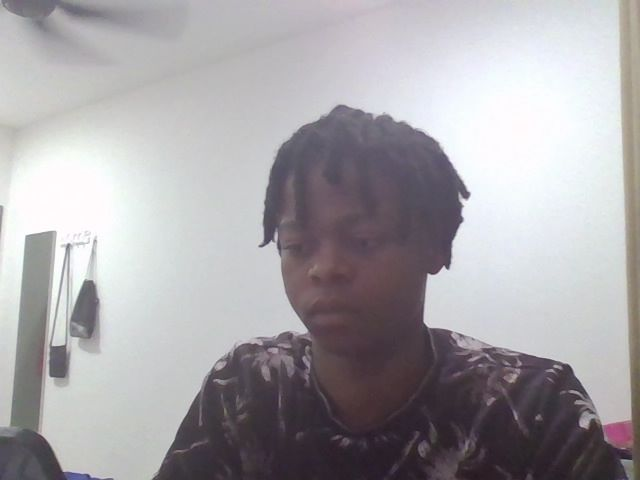

<IPython.core.display.Javascript object>


0: 480x640 1 Car, 28.1ms
Speed: 1.9ms preprocess, 28.1ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)


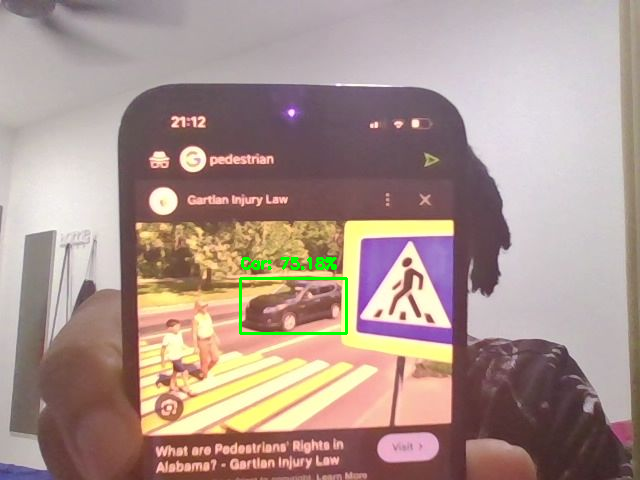

<IPython.core.display.Javascript object>


0: 480x640 1 Car, 28.1ms
Speed: 2.1ms preprocess, 28.1ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)


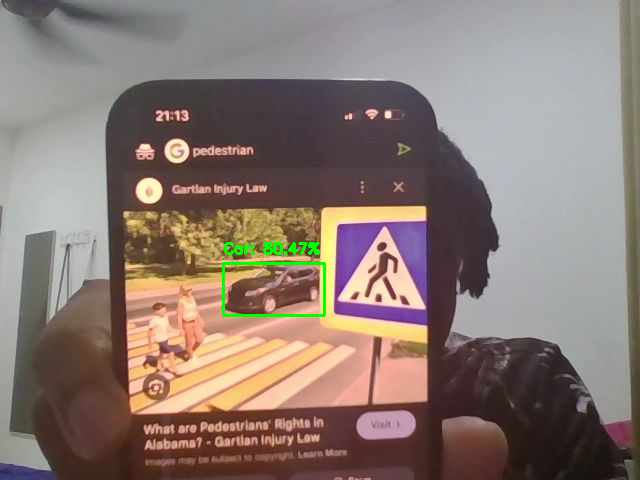

<IPython.core.display.Javascript object>


0: 480x640 1 Car, 28.1ms
Speed: 2.2ms preprocess, 28.1ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)


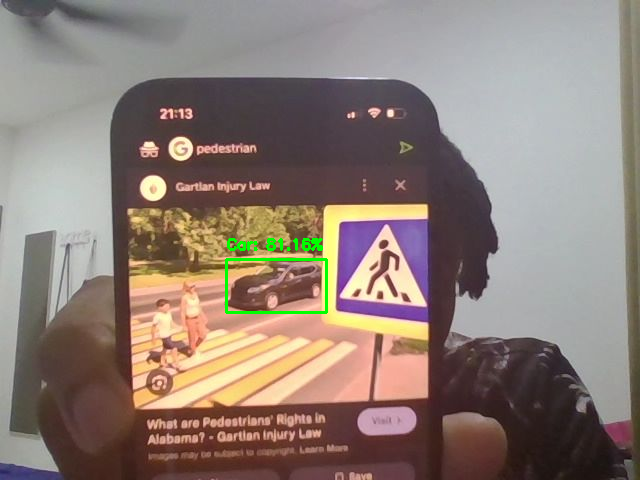

<IPython.core.display.Javascript object>


0: 480x640 1 Car, 28.1ms
Speed: 1.9ms preprocess, 28.1ms inference, 2.9ms postprocess per image at shape (1, 3, 480, 640)


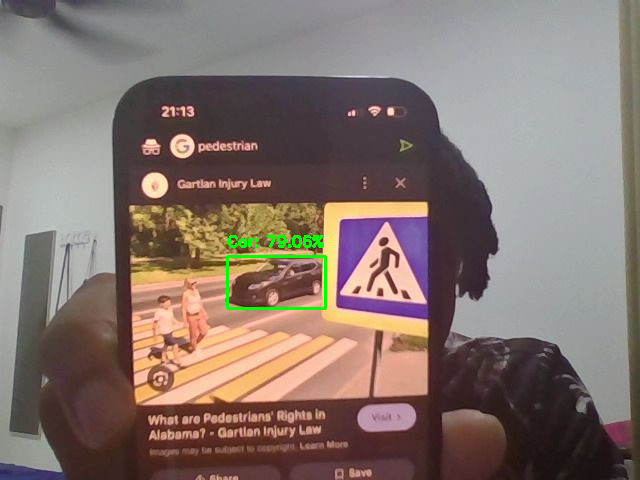

<IPython.core.display.Javascript object>


0: 480x640 1 Car, 28.2ms
Speed: 2.0ms preprocess, 28.2ms inference, 2.2ms postprocess per image at shape (1, 3, 480, 640)


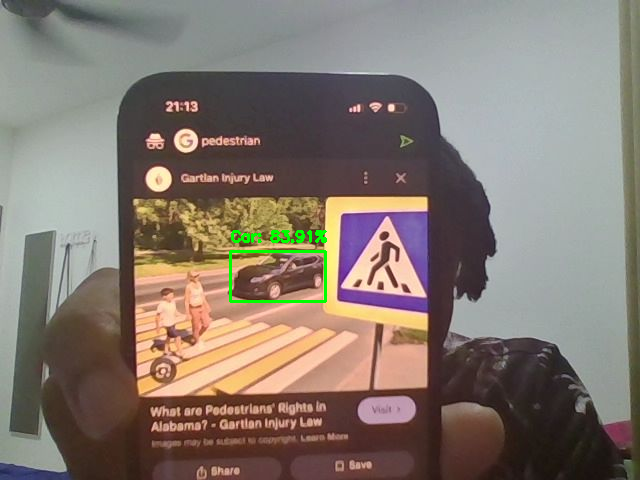

<IPython.core.display.Javascript object>


0: 480x640 2 Cars, 1 Pedestrian, 1 Van, 28.1ms
Speed: 1.9ms preprocess, 28.1ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)


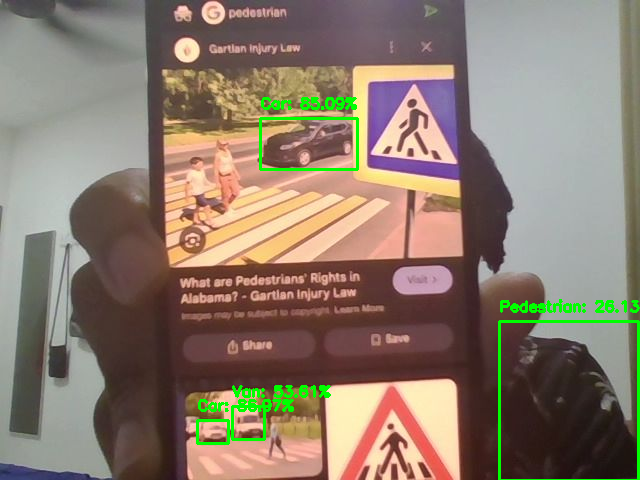

<IPython.core.display.Javascript object>


0: 480x640 (no detections), 28.1ms
Speed: 1.9ms preprocess, 28.1ms inference, 1.2ms postprocess per image at shape (1, 3, 480, 640)


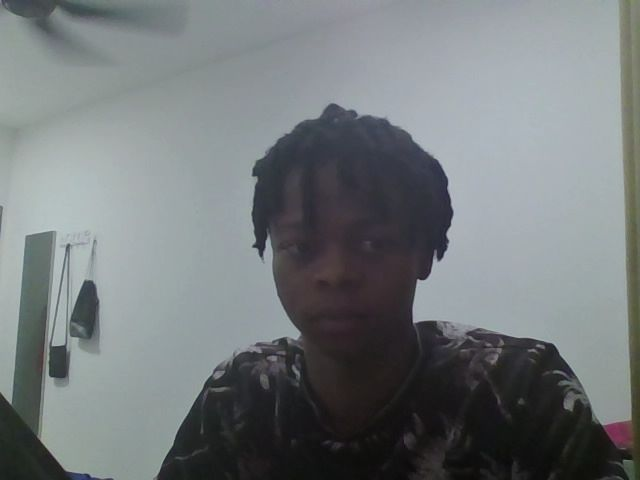

<IPython.core.display.Javascript object>


0: 480x640 1 Car, 1 Pedestrian, 1 Van, 1 Truck, 28.1ms
Speed: 1.9ms preprocess, 28.1ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)


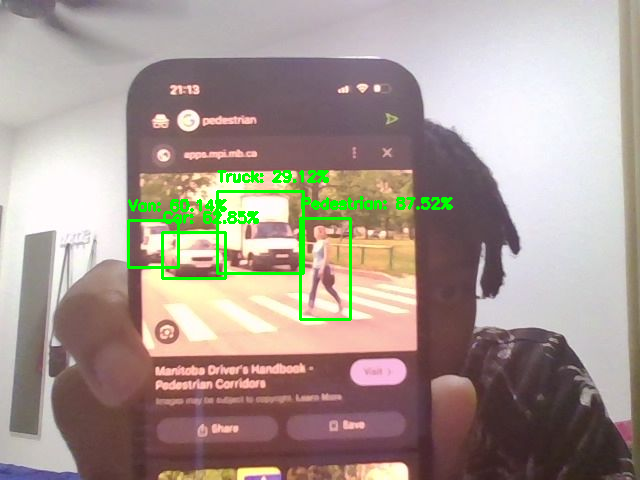

<IPython.core.display.Javascript object>


0: 480x640 1 Car, 1 Pedestrian, 2 Vans, 1 Misc, 28.7ms
Speed: 2.0ms preprocess, 28.7ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)


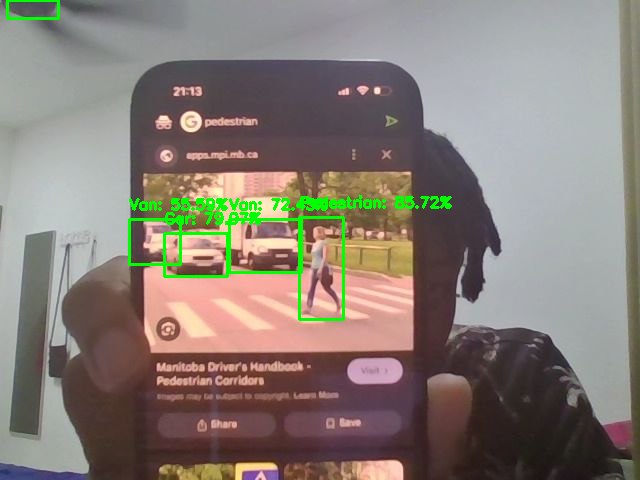

<IPython.core.display.Javascript object>


0: 480x640 1 Car, 1 Pedestrian, 2 Vans, 28.1ms
Speed: 1.9ms preprocess, 28.1ms inference, 2.1ms postprocess per image at shape (1, 3, 480, 640)


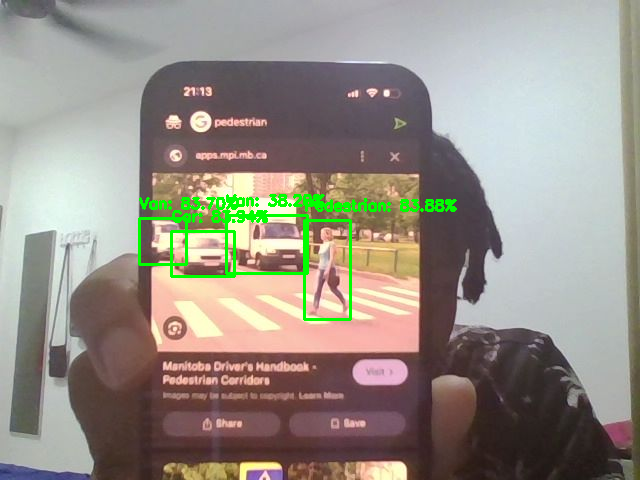

<IPython.core.display.Javascript object>


0: 480x640 1 Pedestrian, 29.9ms
Speed: 3.6ms preprocess, 29.9ms inference, 2.3ms postprocess per image at shape (1, 3, 480, 640)


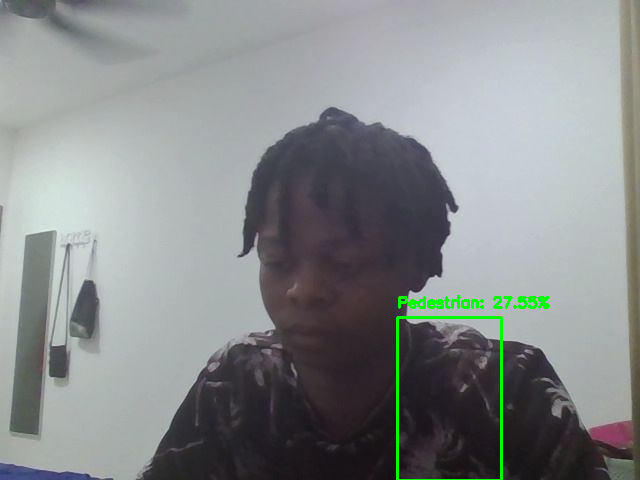

<IPython.core.display.Javascript object>


0: 480x640 1 Car, 28.1ms
Speed: 2.6ms preprocess, 28.1ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


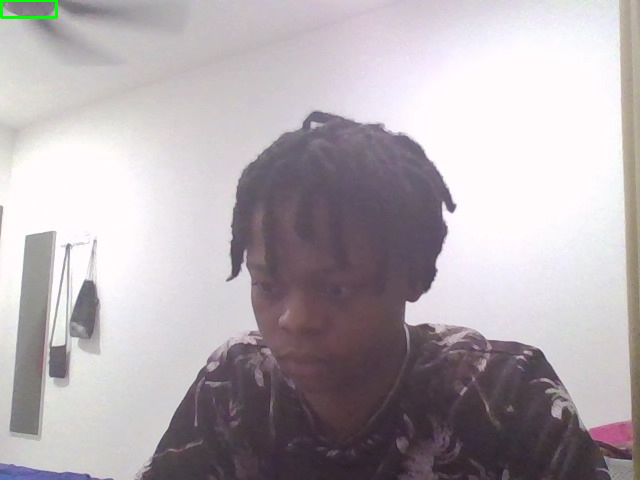

<IPython.core.display.Javascript object>


0: 480x640 (no detections), 28.1ms
Speed: 1.8ms preprocess, 28.1ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)


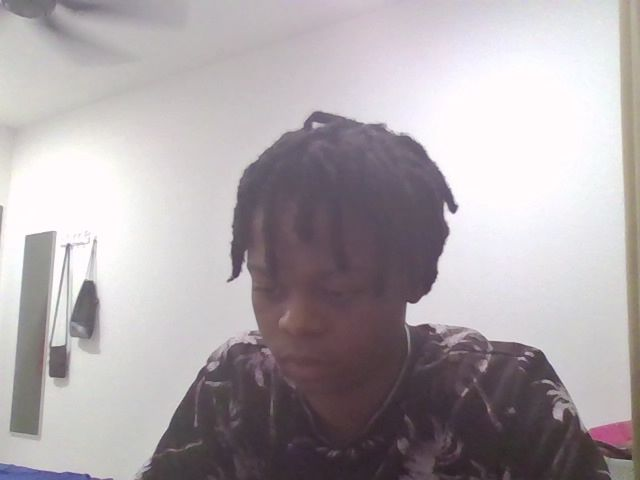

<IPython.core.display.Javascript object>


0: 480x640 1 Pedestrian, 28.1ms
Speed: 2.0ms preprocess, 28.1ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)


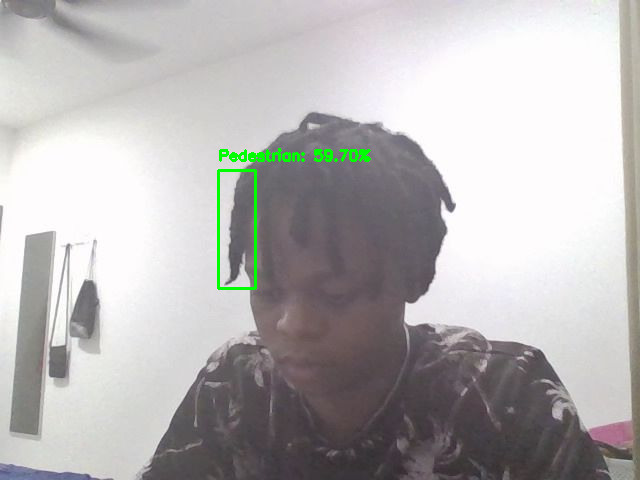

<IPython.core.display.Javascript object>


0: 480x640 (no detections), 68.8ms
Speed: 2.0ms preprocess, 68.8ms inference, 7.3ms postprocess per image at shape (1, 3, 480, 640)


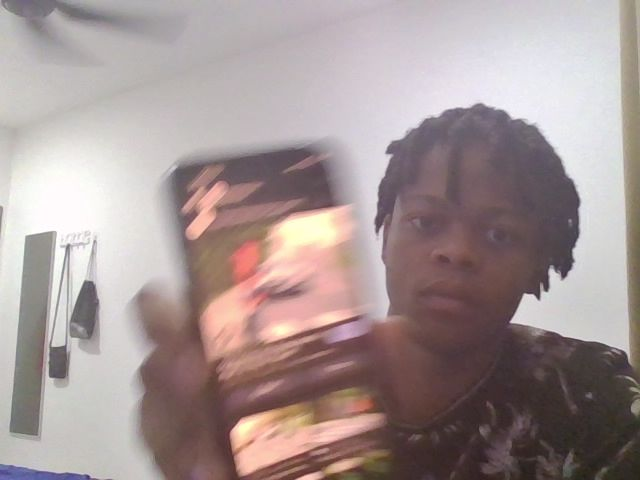

<IPython.core.display.Javascript object>


0: 480x640 1 Car, 2 Pedestrians, 28.1ms
Speed: 2.1ms preprocess, 28.1ms inference, 3.4ms postprocess per image at shape (1, 3, 480, 640)


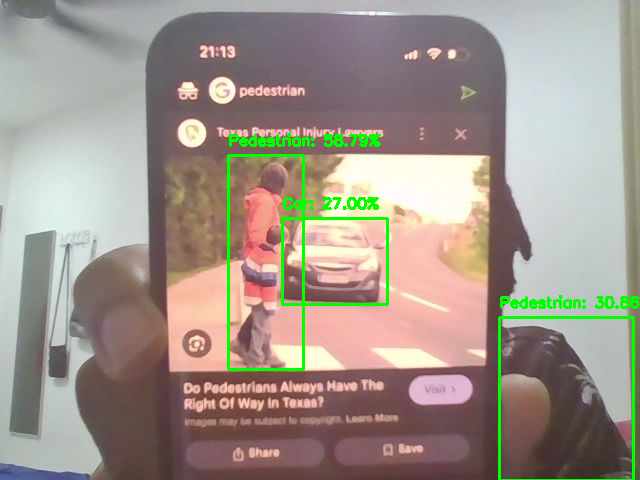

<IPython.core.display.Javascript object>


0: 480x640 1 Car, 2 Pedestrians, 28.1ms
Speed: 1.9ms preprocess, 28.1ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)


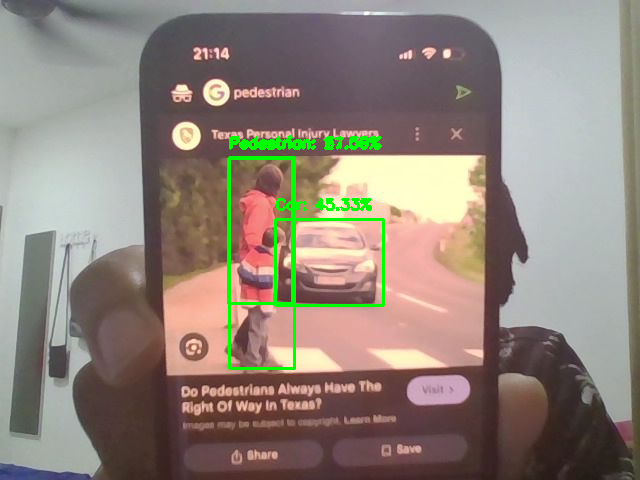

<IPython.core.display.Javascript object>


0: 480x640 2 Cars, 1 Pedestrian, 28.1ms
Speed: 2.0ms preprocess, 28.1ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


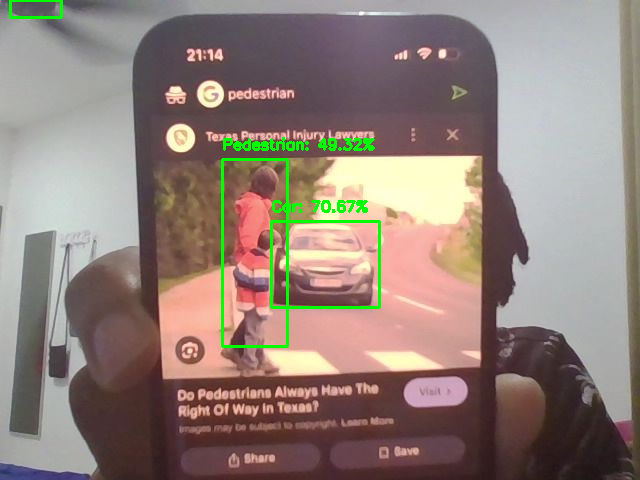

<IPython.core.display.Javascript object>


0: 480x640 1 Car, 1 Pedestrian, 64.2ms
Speed: 2.8ms preprocess, 64.2ms inference, 9.1ms postprocess per image at shape (1, 3, 480, 640)


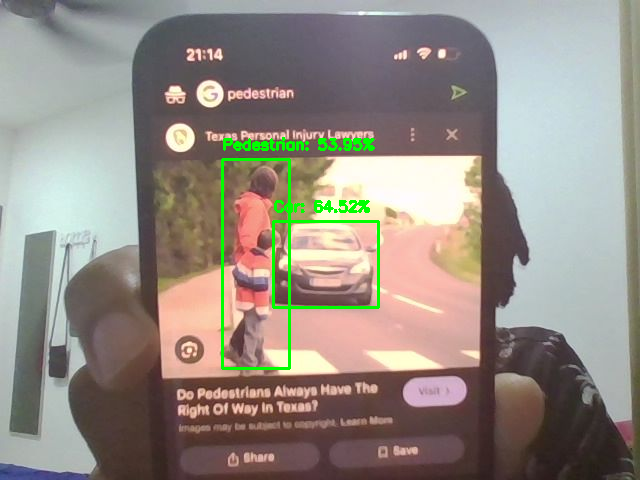

<IPython.core.display.Javascript object>


0: 480x640 1 Car, 2 Pedestrians, 28.1ms
Speed: 2.1ms preprocess, 28.1ms inference, 2.4ms postprocess per image at shape (1, 3, 480, 640)


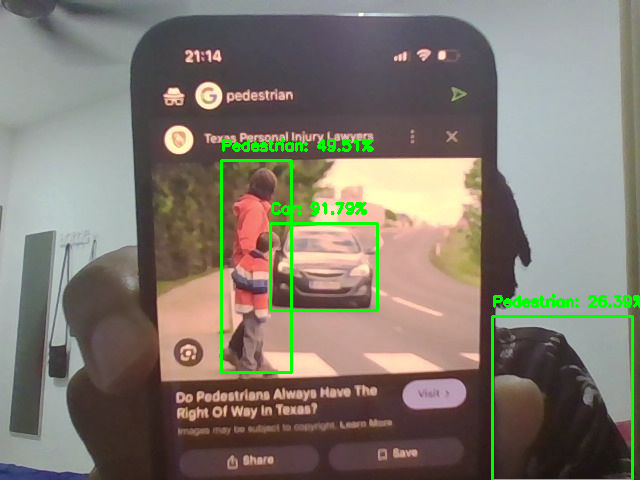

<IPython.core.display.Javascript object>


0: 480x640 (no detections), 28.1ms
Speed: 2.8ms preprocess, 28.1ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


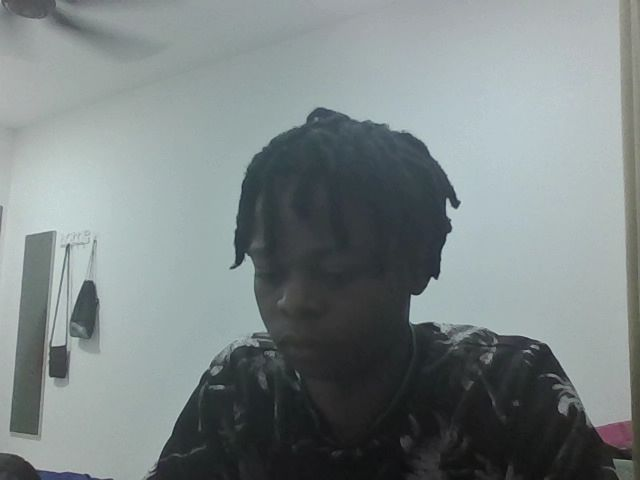

<IPython.core.display.Javascript object>


0: 480x640 1 Car, 28.1ms
Speed: 2.0ms preprocess, 28.1ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)


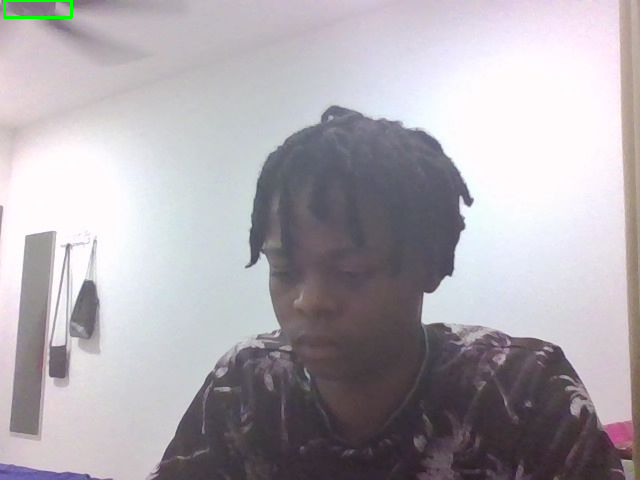

<IPython.core.display.Javascript object>


0: 480x640 (no detections), 28.1ms
Speed: 2.0ms preprocess, 28.1ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)


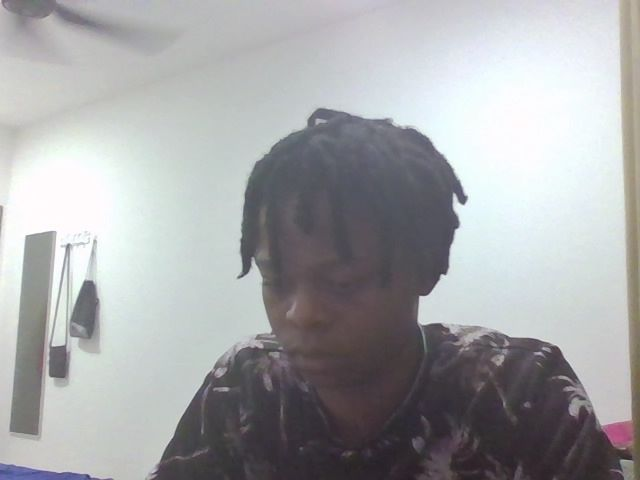

<IPython.core.display.Javascript object>


0: 480x640 (no detections), 28.1ms
Speed: 1.9ms preprocess, 28.1ms inference, 0.8ms postprocess per image at shape (1, 3, 480, 640)


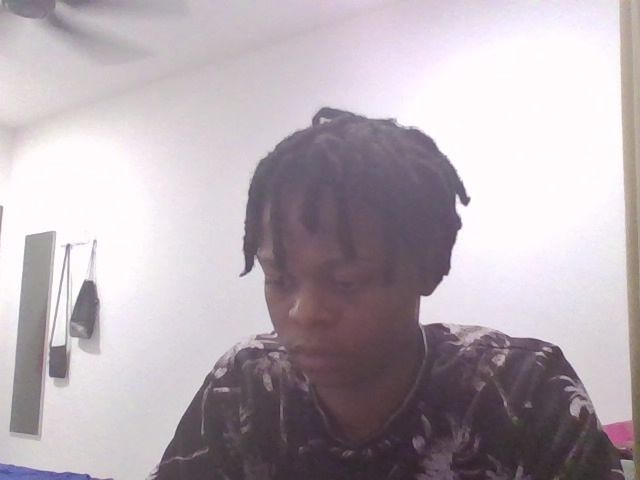

<IPython.core.display.Javascript object>


0: 480x640 3 Cars, 28.1ms
Speed: 2.1ms preprocess, 28.1ms inference, 3.3ms postprocess per image at shape (1, 3, 480, 640)


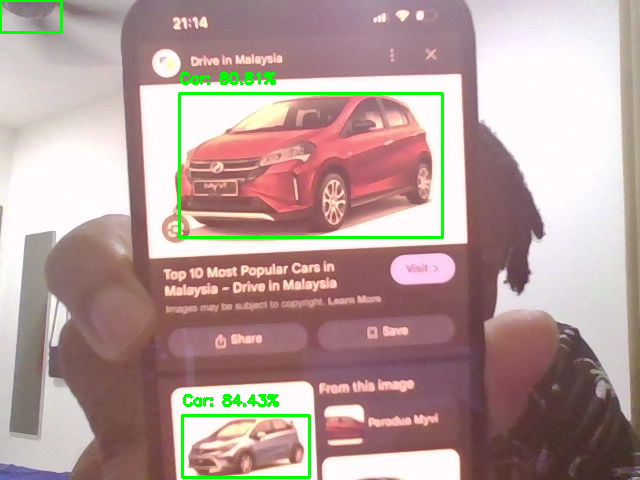

<IPython.core.display.Javascript object>


0: 480x640 3 Cars, 28.2ms
Speed: 2.0ms preprocess, 28.2ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)


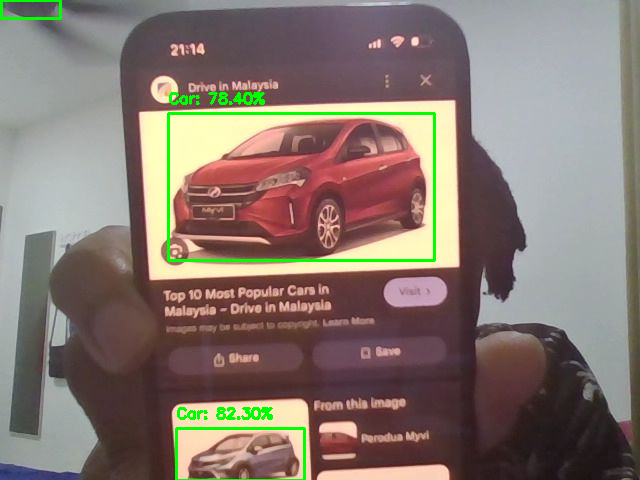

<IPython.core.display.Javascript object>


0: 480x640 2 Cars, 29.0ms
Speed: 3.3ms preprocess, 29.0ms inference, 2.0ms postprocess per image at shape (1, 3, 480, 640)


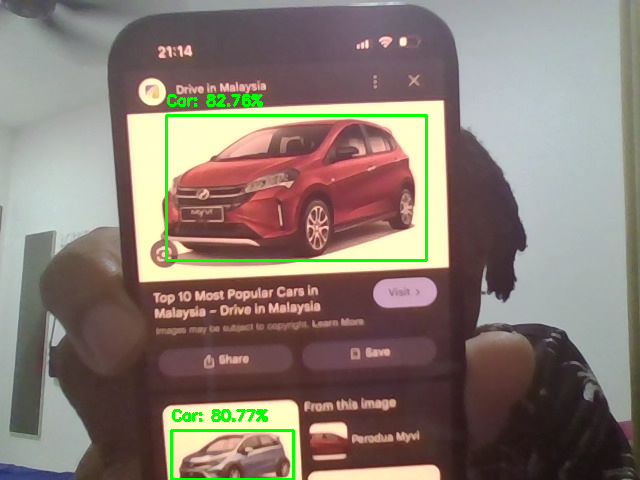

<IPython.core.display.Javascript object>


0: 480x640 (no detections), 28.1ms
Speed: 2.1ms preprocess, 28.1ms inference, 1.0ms postprocess per image at shape (1, 3, 480, 640)


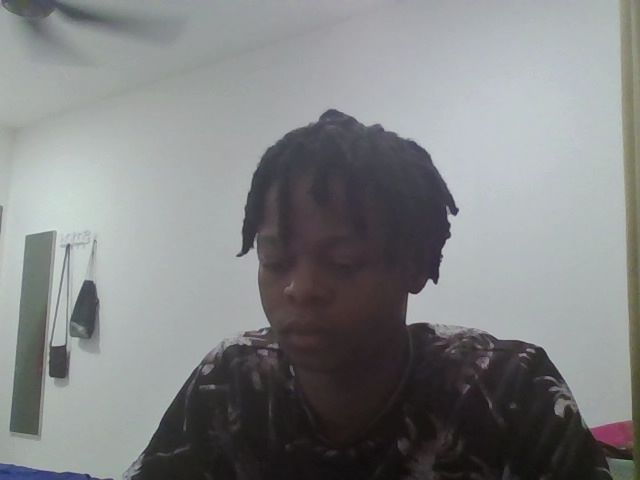

<IPython.core.display.Javascript object>


0: 480x640 (no detections), 28.1ms
Speed: 2.0ms preprocess, 28.1ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)


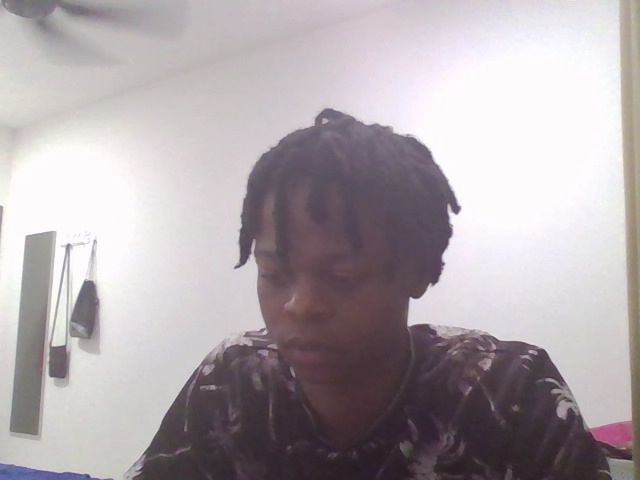

<IPython.core.display.Javascript object>


0: 480x640 1 Van, 1 Misc, 28.1ms
Speed: 2.0ms preprocess, 28.1ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


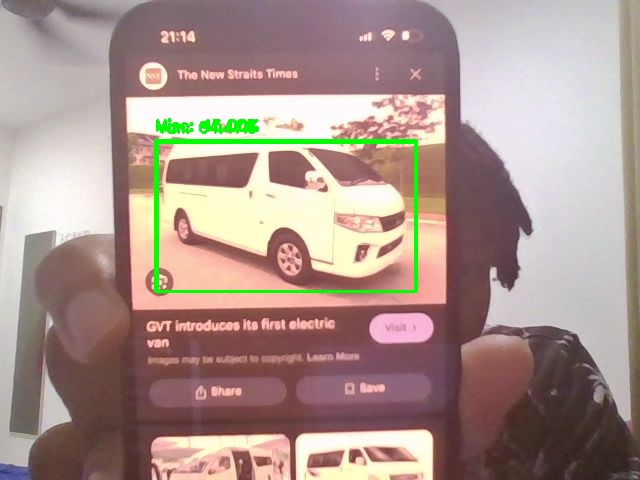

<IPython.core.display.Javascript object>


0: 480x640 1 Car, 2 Vans, 46.3ms
Speed: 3.3ms preprocess, 46.3ms inference, 2.5ms postprocess per image at shape (1, 3, 480, 640)


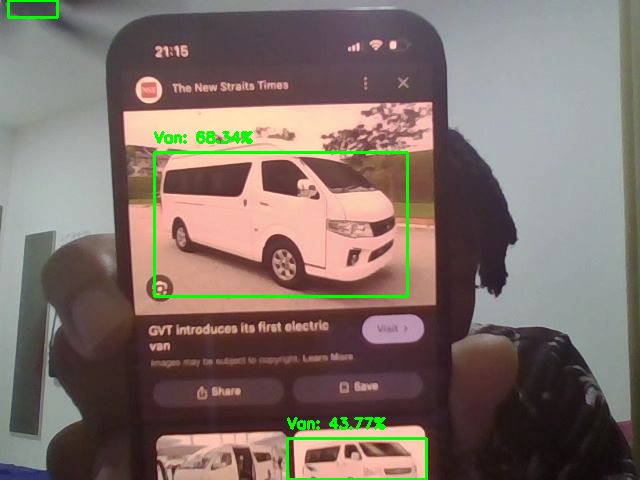

<IPython.core.display.Javascript object>


0: 480x640 2 Vans, 28.1ms
Speed: 2.0ms preprocess, 28.1ms inference, 1.8ms postprocess per image at shape (1, 3, 480, 640)


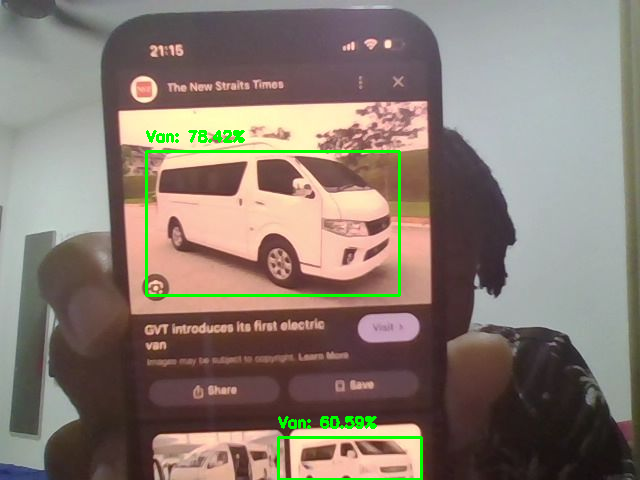

<IPython.core.display.Javascript object>


0: 480x640 2 Vans, 1 Misc, 28.1ms
Speed: 2.0ms preprocess, 28.1ms inference, 1.9ms postprocess per image at shape (1, 3, 480, 640)


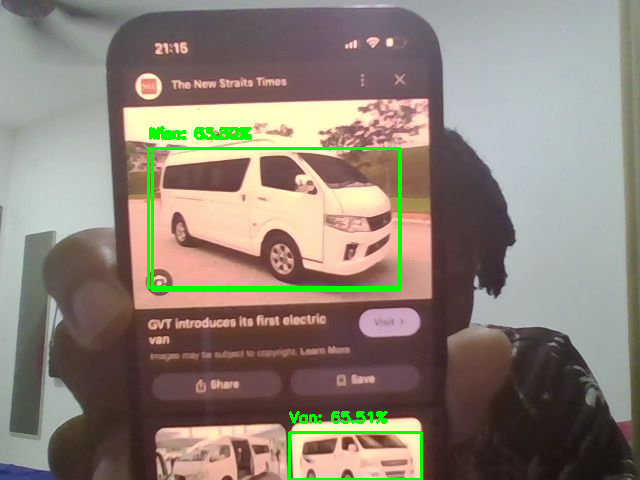

<IPython.core.display.Javascript object>


0: 480x640 (no detections), 28.1ms
Speed: 1.8ms preprocess, 28.1ms inference, 0.9ms postprocess per image at shape (1, 3, 480, 640)


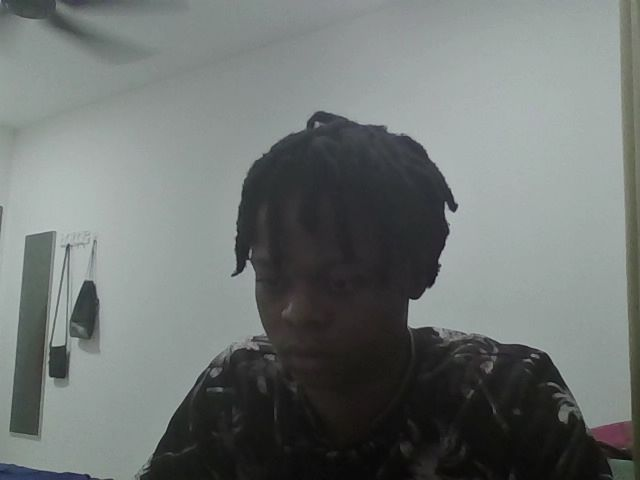

<IPython.core.display.Javascript object>

Detection stopped.


In [ ]:
# Function to capture a single frame from the webcam
def capture_frame(quality=0.8):
    js = Javascript('''
        async function captureFrame(quality) {
            const video = document.createElement('video');
            const stream = await navigator.mediaDevices.getUserMedia({video: true});
            video.srcObject = stream;
            await video.play();
            const canvas = document.createElement('canvas');
            canvas.width = video.videoWidth;
            canvas.height = video.videoHeight;
            canvas.getContext('2d').drawImage(video, 0, 0);
            stream.getTracks().forEach(track => track.stop());
            return canvas.toDataURL('image/jpeg', quality);
        }
    ''')
    display(js)
    data = eval_js(f'captureFrame({quality})')
    binary = b64decode(data.split(',')[1])
    img_array = np.frombuffer(binary, np.uint8)
    return cv2.imdecode(img_array, cv2.IMREAD_COLOR)

# Function to perform object detection on a single frame
def detect_objects_on_frame(frame, model, labels):
    results = model(frame)
    detections = results[0].boxes.data.cpu().numpy()
    class_ids = detections[:, -1].astype(int)

    for detection in detections:
        x1, y1, x2, y2, confidence, class_id = detection
        if confidence > 0.3:

            cv2.rectangle(frame, (int(x1), int(y1)), (int(x2), int(y2)), (0, 255, 0), 2)
            label = f"{list(labels.keys())[list(labels.values()).index(class_id)]}: {confidence * 100:.2f}%"  # Get label from class_id
            cv2.putText(frame, label, (int(x1), int(y1) - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    return frame

# Main function to run detection in Colab
def run_object_detection_colab(model, labels):
    print("Press 'Stop' in Colab to exit the loop.")
    try:
        while True:
            frame = capture_frame()
            if frame is None:
                print("No frame captured.")
                break

            processed_frame = detect_objects_on_frame(frame, model, labels)

            cv2_imshow(processed_frame)
    except KeyboardInterrupt:
        print("Detection stopped.")

run_object_detection_colab(model, classes)
